In [27]:
# -*- coding: utf-8 -*-


import os
from PIL import Image  # 画像処理ライブラリPillow

import torch
import torch.utils.data as data
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torchvision import transforms
import torchvision.models as models # pretrained model

import cv2                          # mean,stdの算出
import pandas as pd
import numpy as np                  # gragh
import matplotlib.pyplot as plt
# %matplotlib inline
import time



# 学習データ、検証データへの分割
def make_filepath_list():
    
    # 学習データ、検証データそれぞれのファイルへのパスを格納したリストを返す
    
    train_file_list = []
    valid_file_list = []
    
    imagedir = r'C:\Users\20044\OneDrive\ドキュメント\kaggle\detect_goldfish\fish_images'

    for top_dir in os.listdir(imagedir):
        file_dir = os.path.join(imagedir, top_dir)
        file_list = os.listdir(file_dir)

        # 学習データ40,検証データ10とする
        num_data = len(file_list)
        num_split = int(num_data - 10)

        # 以下で'\\'を'/'にreplaceしているのはWindowsでのpath出力に対応するため
        train_file_list += [os.path.join(imagedir, top_dir, file).replace('\\', '/') for file in file_list[:num_split]]
        valid_file_list += [os.path.join(imagedir, top_dir, file).replace('\\', '/') for file in file_list[num_split:]]
    
    return train_file_list, valid_file_list

# 前処理クラス
class ImageTransform(object):
    """
    入力画像の前処理クラス
    画像のサイズをリサイズする
    
    Attributes
    ----------
    resize: int
        リサイズ先の画像の大きさ
    mean: (R, G, B)
        各色チャンネルの平均値
    std: (R, G, B)
        各色チャンネルの標準偏差
    """
    def __init__(self, resize, mean, std):
        # 辞書型でMethodを定義
        self.data_trasnform = {
            'train': transforms.Compose([
                # データオーグメンテーション
                transforms.RandomHorizontalFlip(),
                # 画像をresize×resizeの大きさに統一する
                transforms.Resize((resize, resize)),
                # Tensor型に変換する
                transforms.ToTensor(),
                # 色情報の標準化をする
                transforms.Normalize(mean, std)
            ]),
            'valid': transforms.Compose([
                # 画像をresize×resizeの大きさに統一する
                transforms.Resize((resize, resize)),
                # Tensor型に変換する
                transforms.ToTensor(),
                # 色情報の標準化をする
                transforms.Normalize(mean, std)
            ])
        }
    
    def __call__(self, img, phase='train'):
        return self.data_trasnform[phase](img)
    
# Datasetクラス
class FishDataset(data.Dataset):
    """
    魚のDataseクラス。
    PyTorchのDatasetクラスを継承させる。
    
    Attrbutes
    ---------
    file_list: list
        画像のファイルパスを格納したリスト
    classes: list
        魚のラベル名
    transform: object
        前処理クラスのインスタンス
    phase: 'train' or 'valid'
        学習か検証化を設定
    """
    def __init__(self, file_list, classes, transform=None, phase='train'):
        self.file_list = file_list
        self.transform = transform
        self.classes = classes
        self.phase = phase
    
    def __len__(self):
        """
        画像の枚数を返す
        """
        return len(self.file_list)
    
    def __getitem__(self, index):
        """
        前処理した画像データのTensor形式のデータとラベルを取得
        """
        # 指定したindexの画像を読み込む
        img_path = self.file_list[index]
        img = Image.open(img_path).convert('RGB')
        
        # 画像の前処理を実施
        img_transformed = self.transform(img, self.phase)
        
        # 画像ラベルをファイル名から抜き出す
        label = self.file_list[index].split('/')[8][:] # '/'で分けた5番目
        # print(label)

        # ラベル名を数値に変換
        label = self.classes.index(label)
        
        return img_transformed, label

In [ ]:
# # 画素値の平均、標準偏差を算出
# # https://qiita.com/ZESSU/items/40b8bb2cd179371df6ac

# idir_1 = '/content/drive/MyDrive/fish_images/goldfish/'
# idir_2 = '/content/drive/MyDrive/fish_images/fish/'

# num_photo = 50
# bgr_1 = np.zeros((num_photo,3))
# bgr_2 = np.zeros((num_photo,3))

# # idir_1 = '/content/drive/MyDrive/fish_images/goldfish/'
# for k in range(num_photo): 
#     if k < 9:
#         img = cv2.imread(idir_1 + "0000" + str(k+1) + '.jpg')
#         print(idir_1 + "0000" + str(k+1) + '.jpg')
#     else:
#         img = cv2.imread(idir_1 + "000" + str(k+1) + '.jpg')
#         print(idir_1 + "000" + str(k+1) + '.jpg')
    
#     h, w, c = img.shape #height, width, channnel

#     #初期化
#     l=0
#     b_ave=0; g_ave=0; r_ave=0

#     for i in range(h):
#         for j in range(w):
#             #画素値[0,0,0]（Black）を除外してピクセルの和とbgrの画素値の合計を計算する
#             if(img[i,j,0] != 0 or img[i,j,1] != 0 or img[i,j,2] != 0 ):
#                 l+=1    #対象となるピクセル数を計算する
#                 #対象となるピクセルの画素値の和を計算する
#                 b_ave=b_ave+img[i,j,0]
#                 g_ave=g_ave+img[i,j,1]
#                 r_ave=r_ave+img[i,j,2]

#     #画素値合計をピクセル数で除することでRGBの画素値の平均値を求める
#     b_ave=b_ave/l
#     g_ave=g_ave/l
#     r_ave=r_ave/l

#     bgr_1[k]=np.array([b_ave, g_ave, r_ave])
#     print(bgr_1[k])

# _mean = bgr_1.mean(axis=0)
# _std = bgr_1.std(axis=0)

# mean_1 = (_mean / 255) # 0~k+1までのBGRのmean,std / 255 == normalizationのmean(),std()
# std_1 = (_std/ 255)


# # idir_2 = '/content/drive/MyDrive/fish_images/fish/'
# for k in range(num_photo): 

#     if k < 9:
#         img = cv2.imread(idir_1 + "0000" + str(k+1) + '.jpg')
#         print(idir_2 + "0000" + str(k+1) + '.jpg')
#     else:
#         img = cv2.imread(idir_1 + "000" + str(k+1) + '.jpg')
#         print(idir_2 + "000" + str(k+1) + '.jpg')
    
#     h, w, c = img.shape #height, width, channnel

#     #初期化
#     l=0
#     b_ave=0; g_ave=0; r_ave=0

#     for i in range(h):
#         for j in range(w):
#             #画素値[0,0,0]（Black）を除外してピクセルの和とbgrの画素値の合計を計算する
#             if(img[i,j,0] != 0 or img[i,j,1] != 0 or img[i,j,2] != 0 ):
#                 l+=1    #対象となるピクセル数を計算する
#                 #対象となるピクセルの画素値の和を計算する
#                 b_ave=b_ave+img[i,j,0]
#                 g_ave=g_ave+img[i,j,1]
#                 r_ave=r_ave+img[i,j,2]

#     #画素値合計をピクセル数で除することでRGBの画素値の平均値を求める
#     b_ave=b_ave/l
#     g_ave=g_ave/l
#     r_ave=r_ave/l

#     bgr_2[k]=np.array([b_ave, g_ave, r_ave])
#     print(bgr_2[k])
# _mean = bgr_2.mean(axis=0)
# _std = bgr_2.std(axis=0)

# mean_2 = (_mean / 255) # 0~k+1までのBGRのmean,std / 255 == normalizationのmean(),std()
# std_2 = (_std/ 255)


# mean = (mean_1 + mean_2) / 2
# std = (std_1 + std_2) / 2

# mean = np.round(mean, 3)
# std = np.round(std, 3)

# mean = mean[::-1] # BGR,RGB変換
# print(mean)
# std = std[::-1]
# print(std)

device: cpu 

Epoch 1/5
-------------
train Loss: 0.1137 Acc: 0.0375
train Loss: 0.0405 Acc: 0.0875
train Loss: 0.0495 Acc: 0.1375
train Loss: 0.0101 Acc: 0.2375
train Loss: 0.0065 Acc: 0.3500
train Loss: 0.0121 Acc: 0.4500
train Loss: 0.0431 Acc: 0.5250
train Loss: 0.0272 Acc: 0.5875
valid Loss: 0.0697 Acc: 0.8000

Elapsed time: 11.970 sec
Epoch 2/5
-------------
train Loss: 0.0135 Acc: 0.1125
train Loss: 0.0141 Acc: 0.2000
train Loss: 0.0080 Acc: 0.3000
train Loss: 0.0171 Acc: 0.3875
train Loss: 0.0078 Acc: 0.5000
train Loss: 0.0021 Acc: 0.6125
train Loss: 0.0013 Acc: 0.7250
train Loss: 0.0018 Acc: 0.8500
valid Loss: 0.0277 Acc: 0.8500

Elapsed time: 22.157 sec
Epoch 3/5
-------------
train Loss: 0.0006 Acc: 0.1250
train Loss: 0.0001 Acc: 0.2500
train Loss: 0.0007 Acc: 0.3750
train Loss: 0.0074 Acc: 0.4625
train Loss: 0.0136 Acc: 0.5625
train Loss: 0.0019 Acc: 0.6875
train Loss: 0.0009 Acc: 0.8125
train Loss: 0.0222 Acc: 0.9125
valid Loss: 0.0966 Acc: 0.5000

Elapsed time: 31.951 sec

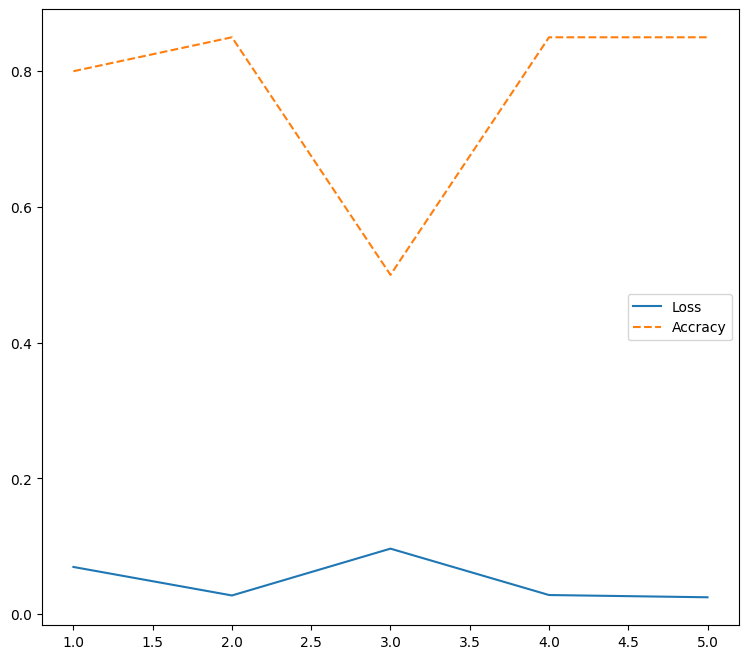

In [29]:
time_start = time.time()

#再現性を保つためにseedを固定
seed = 11
#random.seed(seed)
#np.random.seed(seed)  
torch.manual_seed(seed) 

# 各種パラメータの用意
# クラス名
myclasses = [
    'fish',  'goldfish',
]

# リサイズ先の画像サイズ
resize = 300

# mean = tuple(mean) # mean = (0.549, 0.494, 0.44)
# std = tuple(std)  # std = (0.262, 0.239, 0.246)

mean = (0.549, 0.494, 0.44)
std = (0.262, 0.239, 0.246)

# バッチサイズの指定
batch_size = 10  

# エポック数
num_epochs = 5

# GPU使用を試みる
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print('device:',device,'\n')

# 2. 前処理
# 学習データ、検証データのファイルパスを格納したリストを取得する
train_file_list, valid_file_list = make_filepath_list()

# 3. Datasetの作成
train_dataset = FishDataset(
    file_list=train_file_list, classes=myclasses,
    transform=ImageTransform(resize, mean, std),
    phase='train'
)

valid_dataset = FishDataset(
    file_list=valid_file_list, classes=myclasses,
    transform=ImageTransform(resize, mean, std),
    phase='valid'
)

# 4. DataLoaderの作成
train_dataloader = data.DataLoader(
    train_dataset, batch_size=batch_size, shuffle=True)

valid_dataloader = data.DataLoader(
    valid_dataset, batch_size=32, shuffle=False)

# 辞書にまとめる
dataloaders_dict = {
    'train': train_dataloader, 
    'valid': valid_dataloader
}

# 5. ネットワークの定義
net = models.alexnet(pretrained = True)
net.fc = nn.Linear(in_features=4096, out_features=2)
net = net.to(device)                    

# 6. 損失関数の定義
criterion = nn.CrossEntropyLoss()
# 7. 最適化手法の定義
optimizer = optim.SGD(net.parameters(), lr=0.005)

# 8. 学習・検証
epoch_losses = np.empty(0, dtype=float)

epoch_accs = np.empty(0, dtype=float)

for epoch in range(num_epochs):
    print('Epoch {}/{}'.format(epoch + 1, num_epochs))
    print('-------------')

    for phase in ['train', 'valid']:
        if phase == 'train':
            # 学習モードに設定
            net.train()
        else:
            # 訓練モードに設定
            net.eval()
            
        # epochの損失和
        epoch_loss = 0.0
        # epochの正解数
        epoch_corrects = 0.0
        
        for inputs, labels in dataloaders_dict[phase]:
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            # optimizerを初期化
            optimizer.zero_grad()
            
            # 学習時のみ勾配を計算させる設定にする
            with torch.set_grad_enabled(phase == 'train'):
                
                outputs = net(inputs)
                
                # 損失を計算
                loss = criterion(outputs, labels)
                
                # ラベルを予測
                _, preds = torch.max(outputs, 1)
                
                # 訓練時は逆伝搬の計算
                if phase == 'train':
                    # 逆伝搬の計算
                    loss.backward()
                    
                    # パラメータ更新
                    optimizer.step()
                    
                # イテレーション結果の計算
                # lossの合計を更新
                # PyTorchの仕様上各バッチ内での平均のlossが計算される。
                # データ数を掛けることで平均から合計に変換をしている。
                # 損失和は「全データの損失/データ数」で計算されるため、
                # 平均のままだと損失和を求めることができないため。

                epoch_loss += loss.item()
                
                # 正解数の合計を更新
                epoch_corrects += torch.sum(preds == labels.data)


                # epochごとのlossと正解率を表示
                epoch_loss = epoch_loss / len(dataloaders_dict[phase].dataset)
                epoch_acc = epoch_corrects.double() / len(dataloaders_dict[phase].dataset)
                
                # 一時的保存
                _epoch_loss = epoch_loss
                _epoch_acc = epoch_acc.item()

                print('{} Loss: {:.4f} Acc: {:.4f}'.format(phase, epoch_loss, epoch_acc))

    # 1 epoch
    epoch_losses = np.append(epoch_losses, _epoch_loss)
    epoch_accs = np.append(epoch_accs, _epoch_acc)

    time_end = time.time()
    print('\nElapsed time: {:.3f} sec'.format(time_end - time_start))

# 5 epoch 
x = np.arange(1, num_epochs + 1, 1)
plt.figure(figsize=(9,8))
plt.plot(x, epoch_losses, label = "Loss")
plt.plot(x, epoch_accs, linestyle="--", label = "Accracy")
plt.legend()
plt.show()

In [33]:
# モデルを保存、
PATH = './alex_net.pth'
torch.save(net, PATH)
net = torch.load(PATH)
net.eval()

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5, inplace=False)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
 

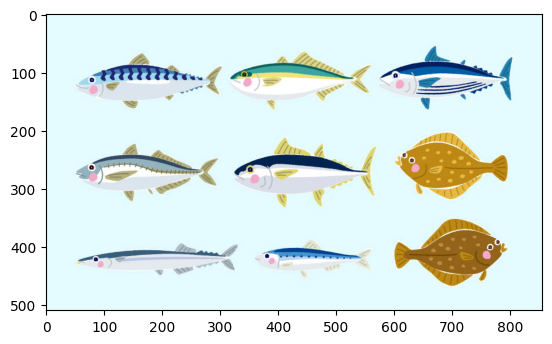

Predicted label: fish


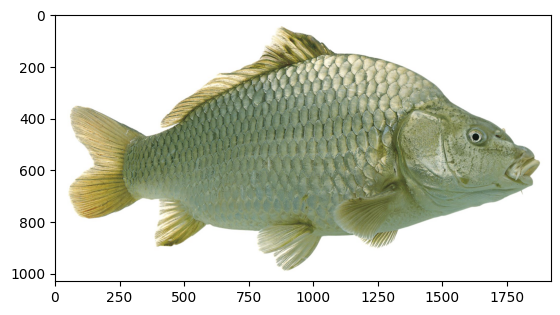

Predicted label: fish


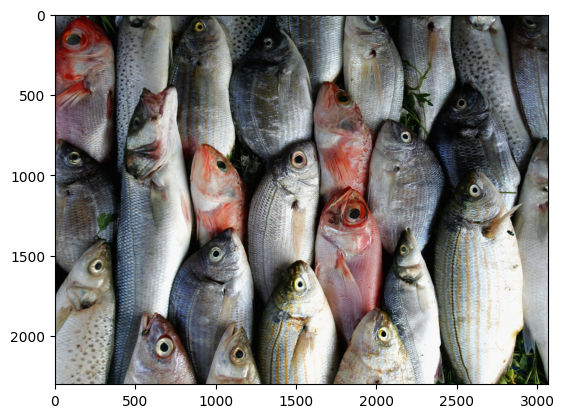

Predicted label: fish


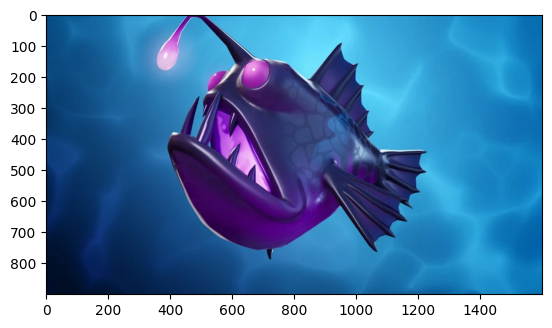

Predicted label: fish


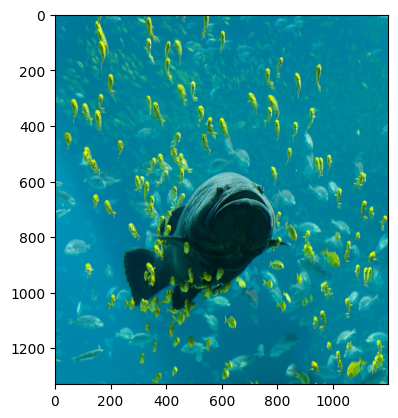

Predicted label: fish


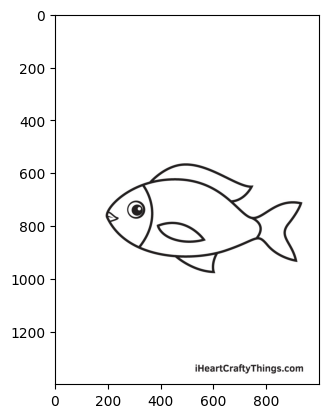

Predicted label: fish


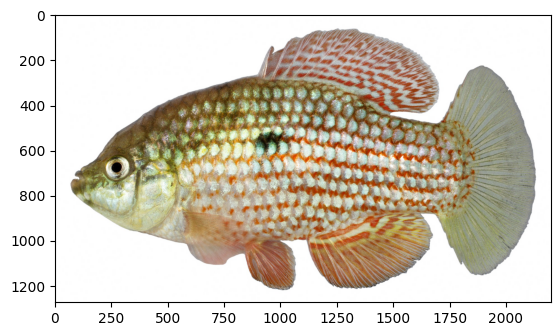

Predicted label: fish


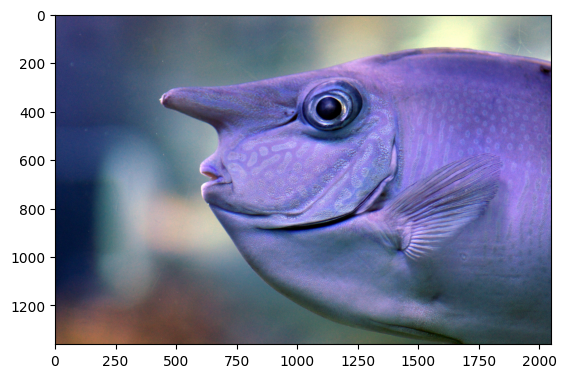

Predicted label: fish


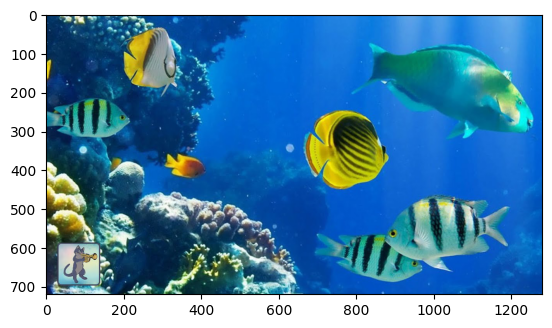

Predicted label: fish


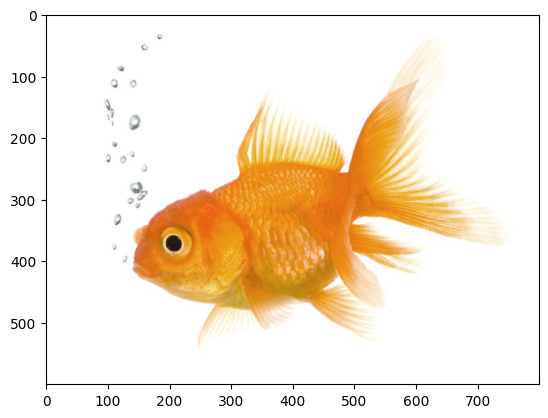

Predicted label: fish


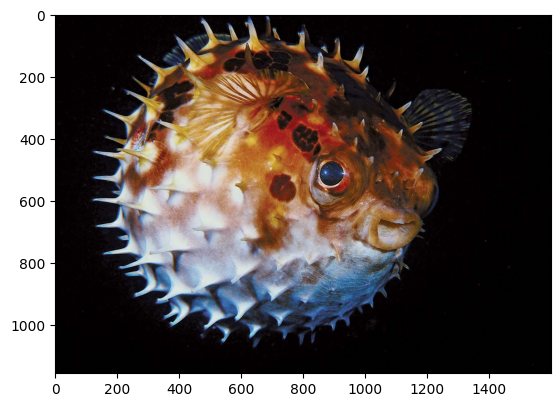

Predicted label: fish


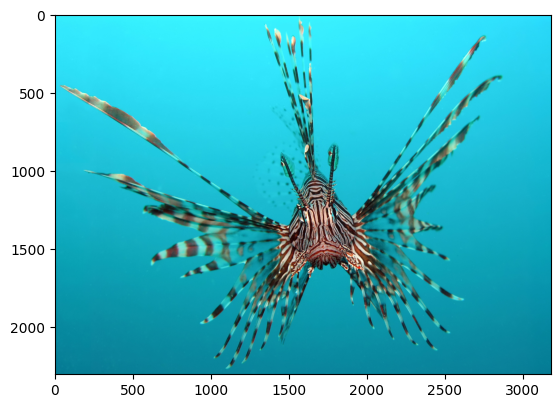

Predicted label: fish


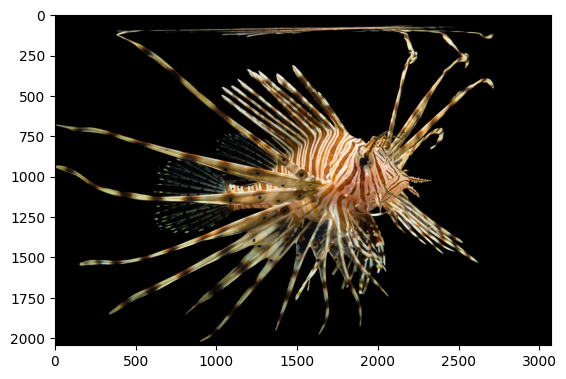

Predicted label: fish


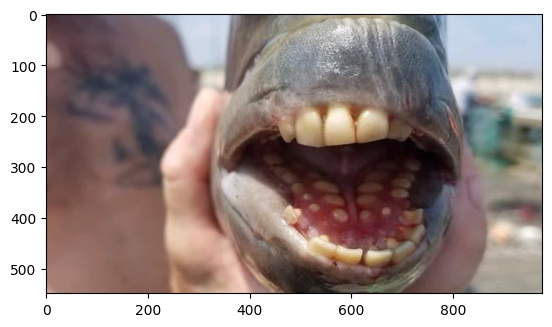

Predicted label: fish


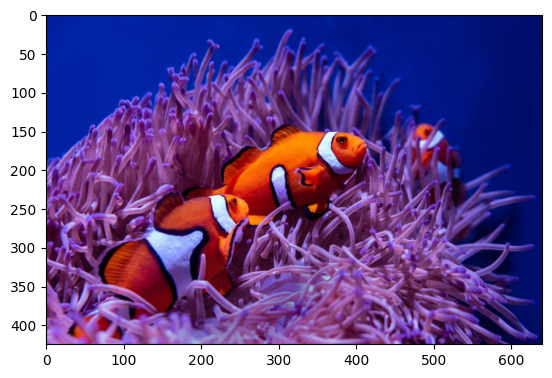

Predicted label: fish


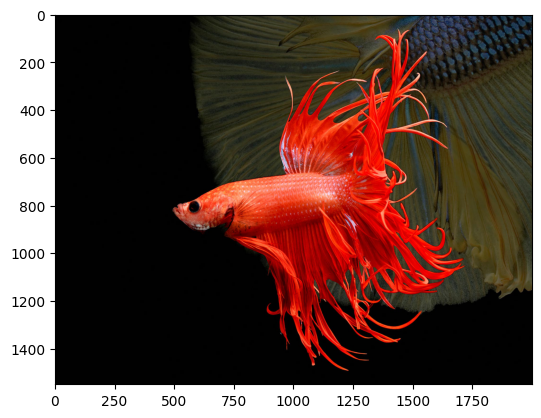

Predicted label: fish


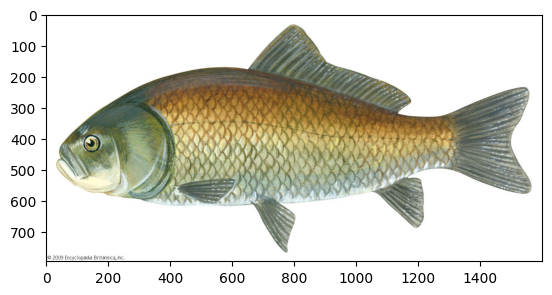

Predicted label: fish
error


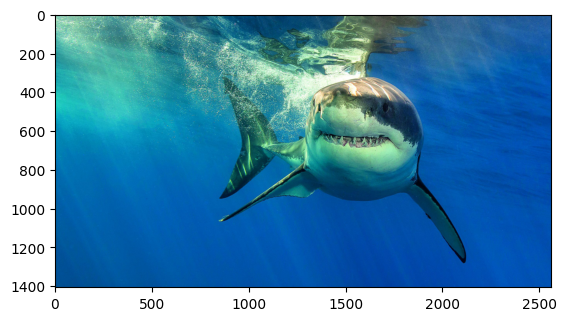

Predicted label: fish


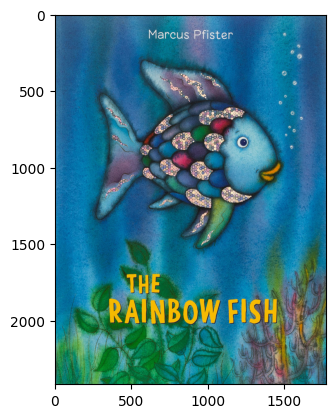

Predicted label: fish


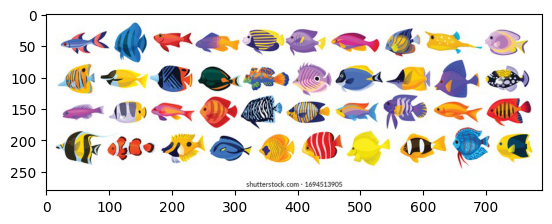

Predicted label: fish


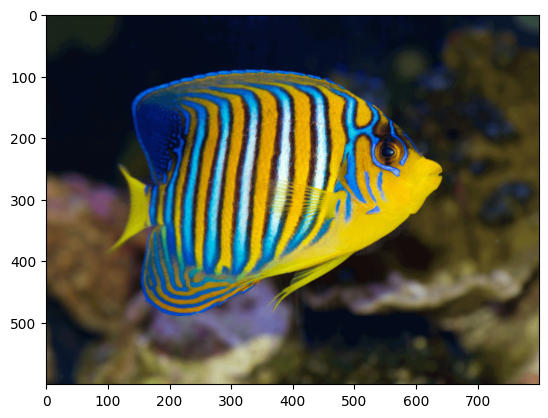

Predicted label: fish


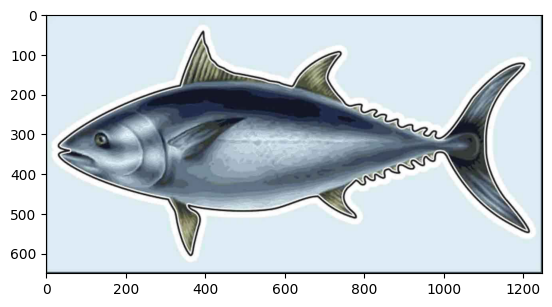

Predicted label: fish


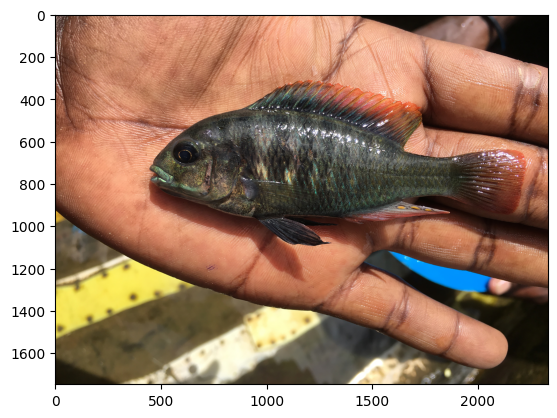

Predicted label: fish


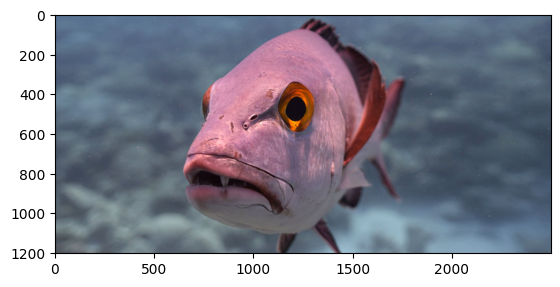

Predicted label: fish


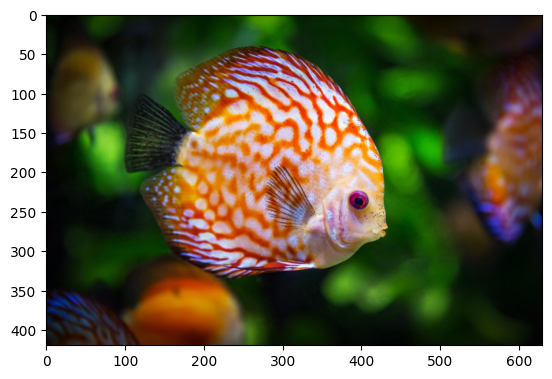

Predicted label: fish


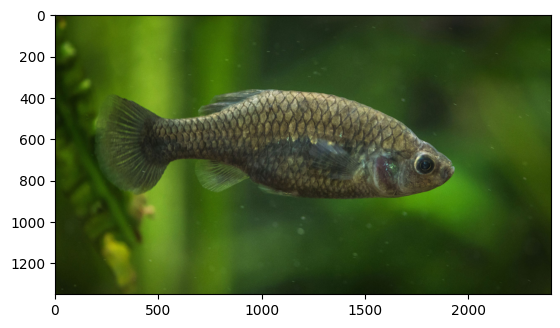

Predicted label: fish


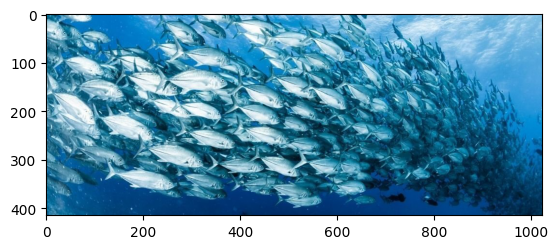

Predicted label: fish


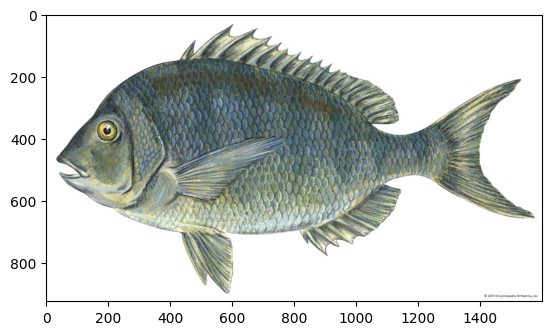

Predicted label: fish


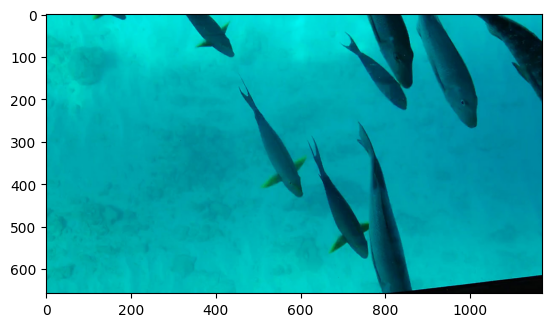

Predicted label: fish


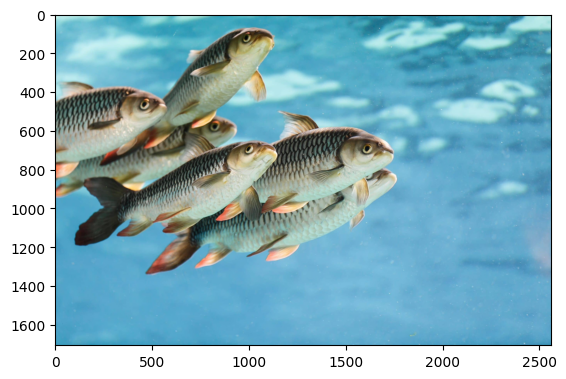

Predicted label: fish


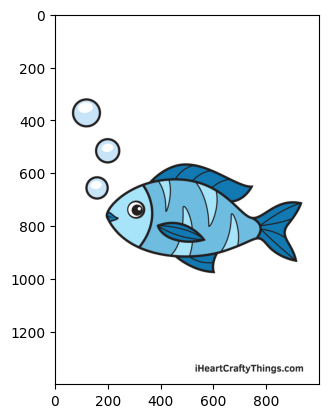

Predicted label: fish


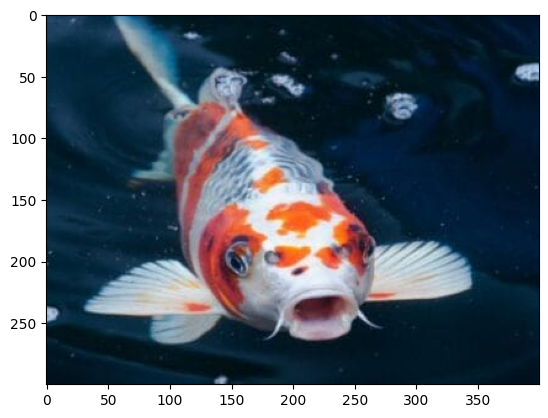

Predicted label: fish


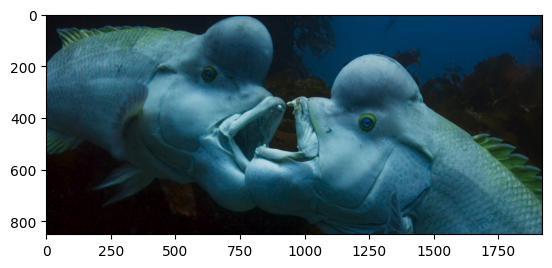

Predicted label: fish


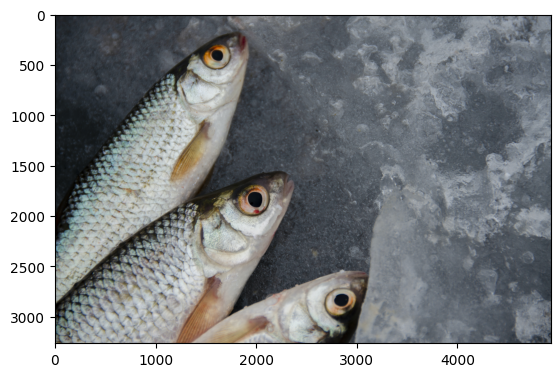

Predicted label: fish


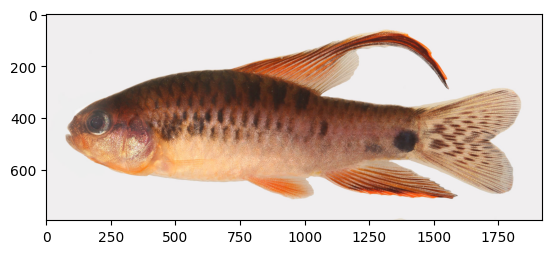

Predicted label: fish
error


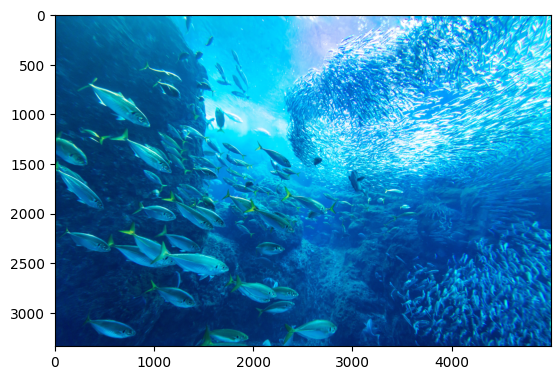

Predicted label: fish


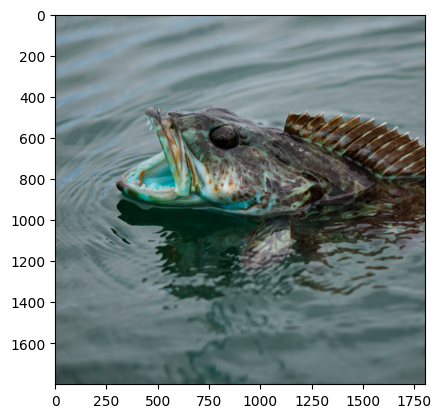

Predicted label: fish


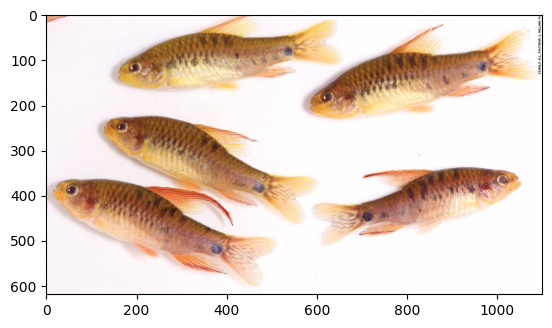

Predicted label: fish


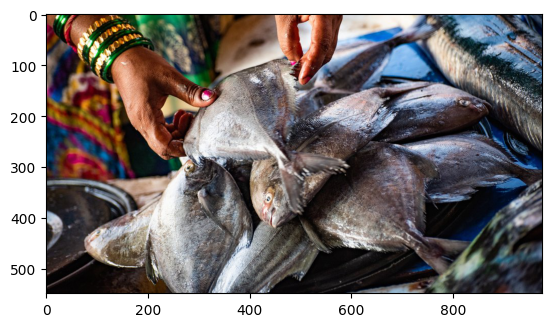

Predicted label: fish


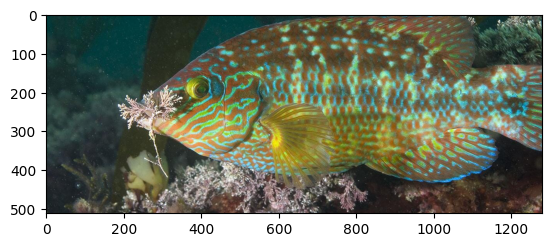

Predicted label: fish


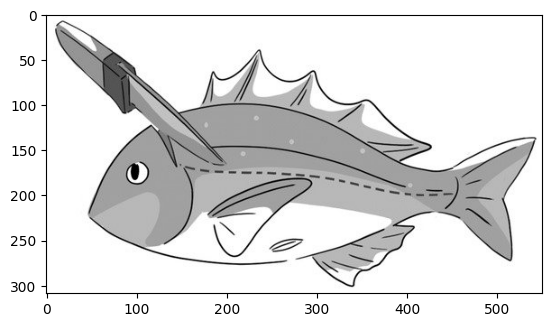

Predicted label: fish


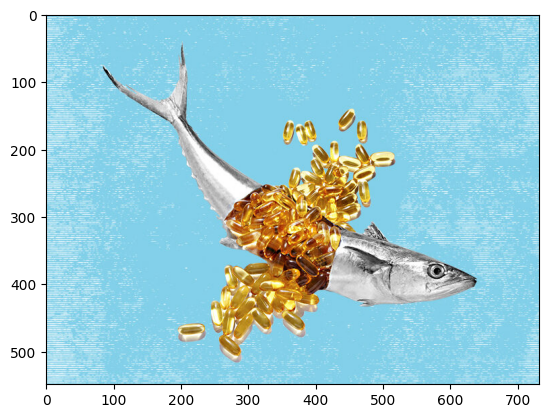

Predicted label: fish


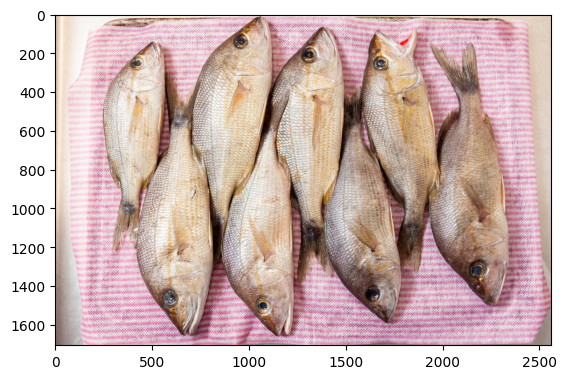

Predicted label: fish


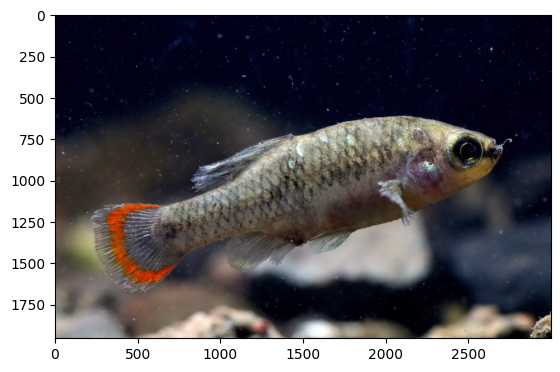

Predicted label: fish


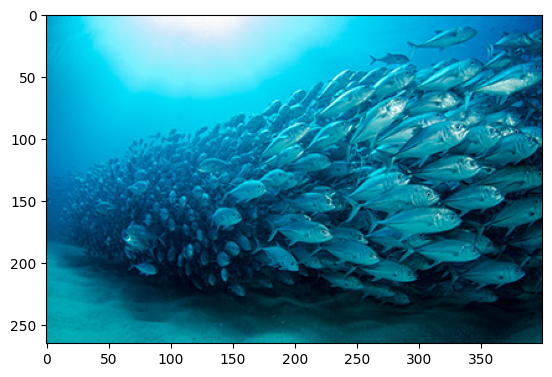

Predicted label: fish


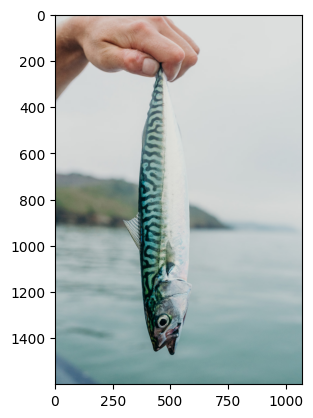

Predicted label: fish


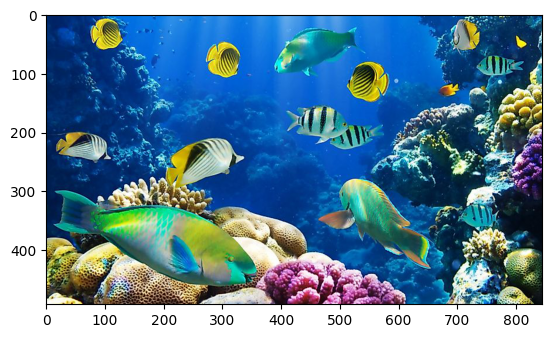

Predicted label: fish


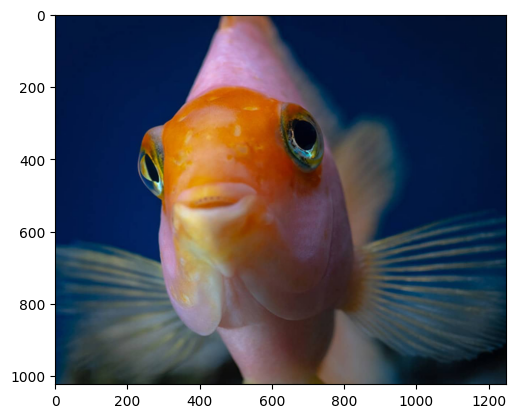

Predicted label: goldfish


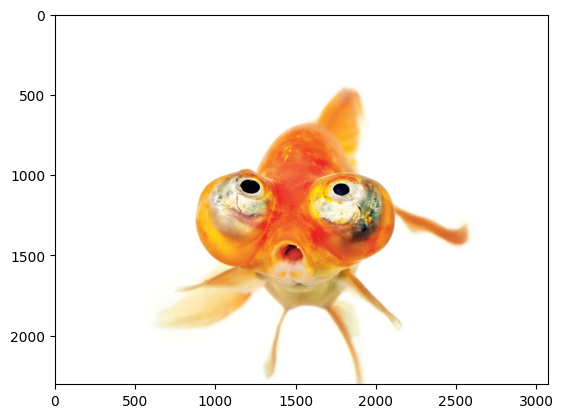

Predicted label: goldfish


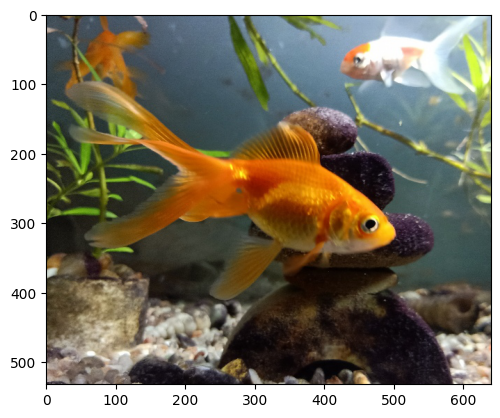

Predicted label: goldfish


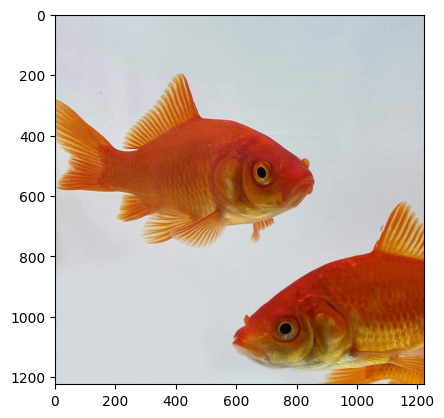

Predicted label: goldfish


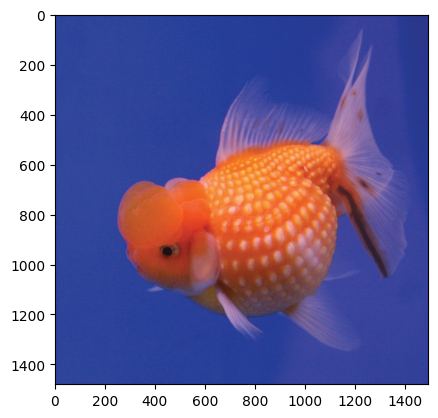

Predicted label: goldfish


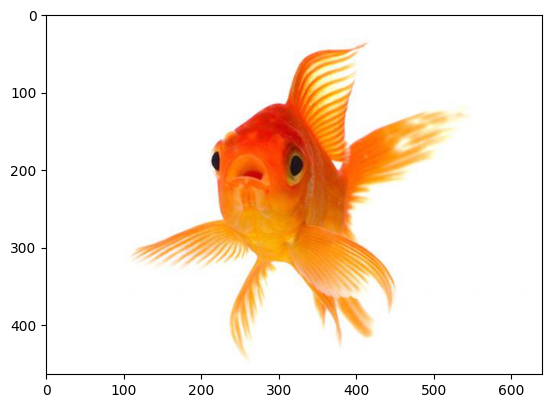

Predicted label: goldfish


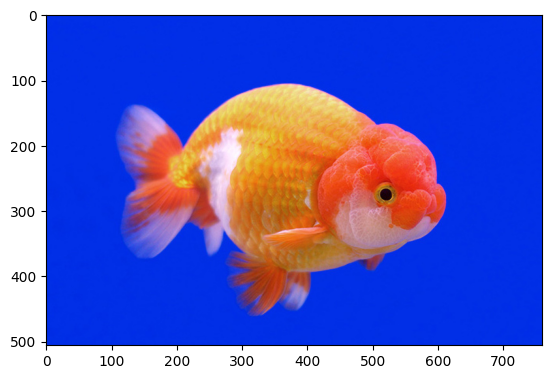

Predicted label: goldfish


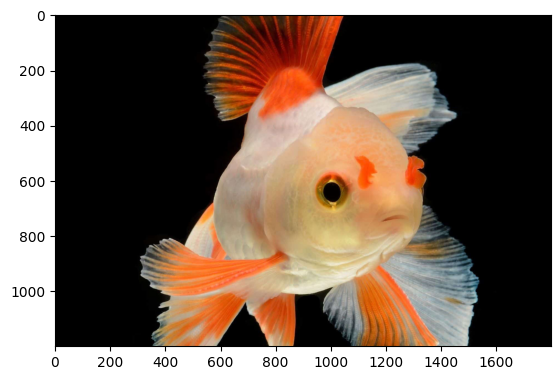

Predicted label: goldfish
error


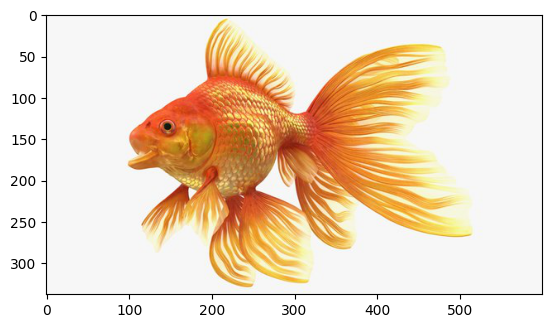

Predicted label: goldfish
error


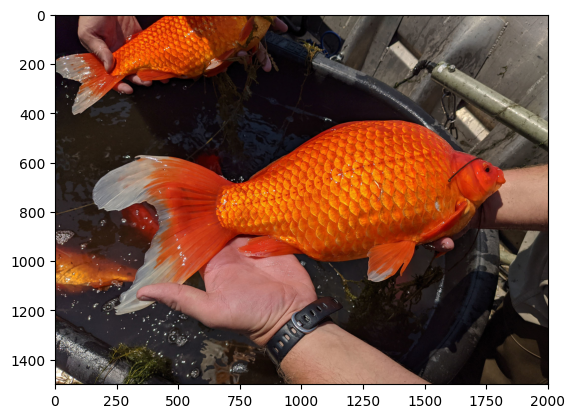

Predicted label: goldfish


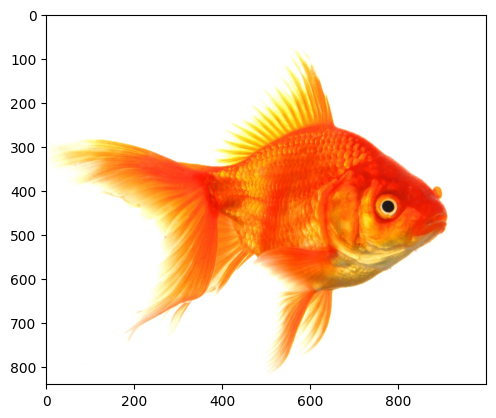

Predicted label: goldfish


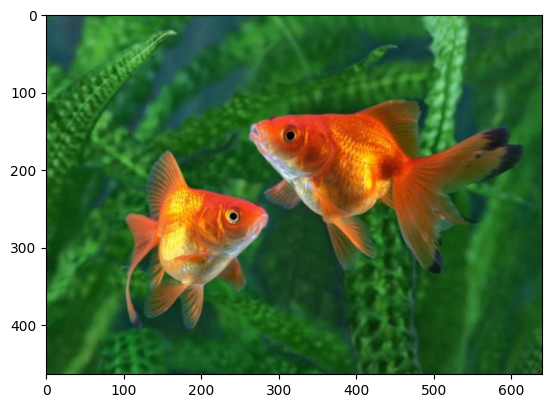

Predicted label: goldfish


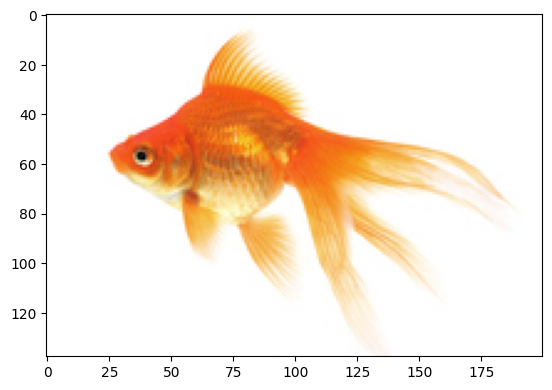

Predicted label: goldfish


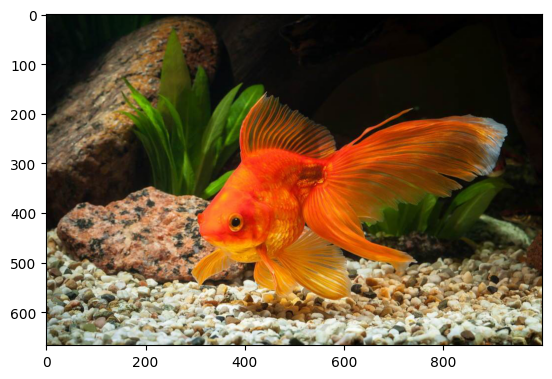

Predicted label: goldfish


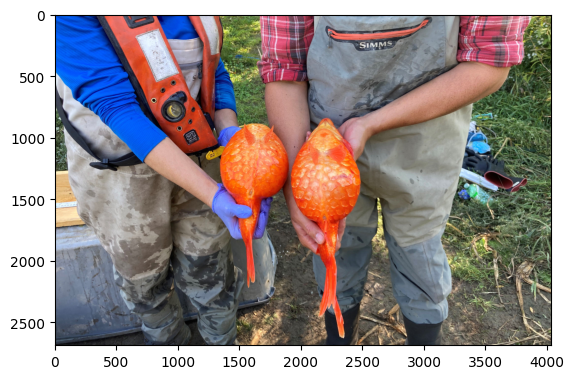

Predicted label: goldfish


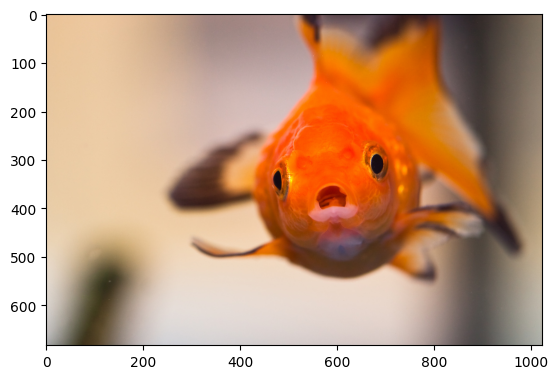

Predicted label: goldfish


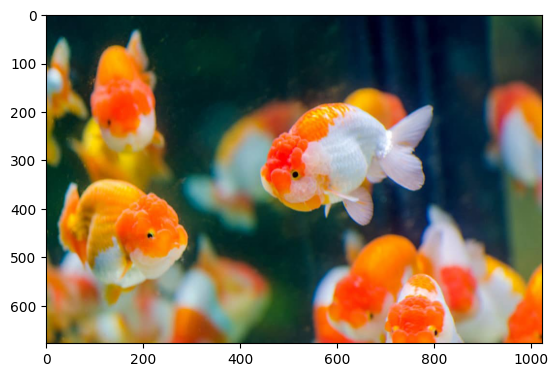

Predicted label: goldfish


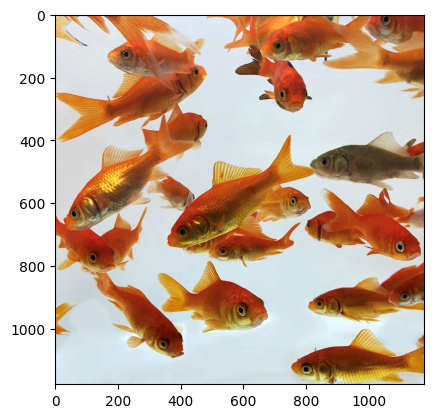

Predicted label: goldfish


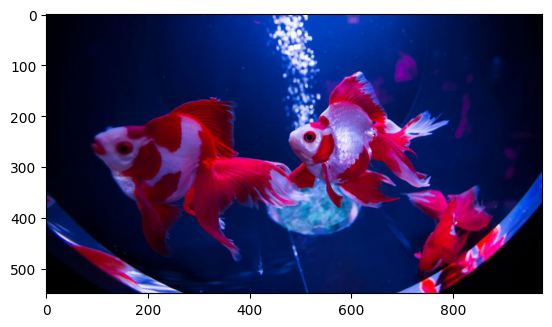

Predicted label: goldfish


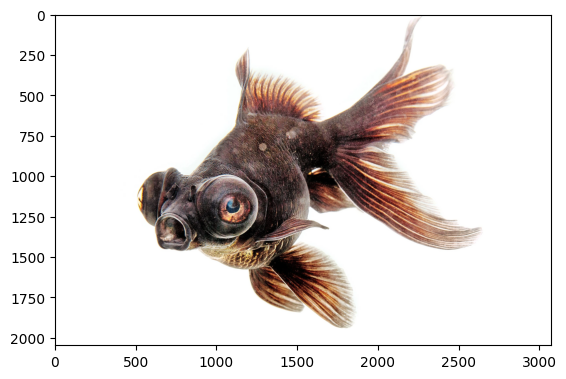

Predicted label: goldfish


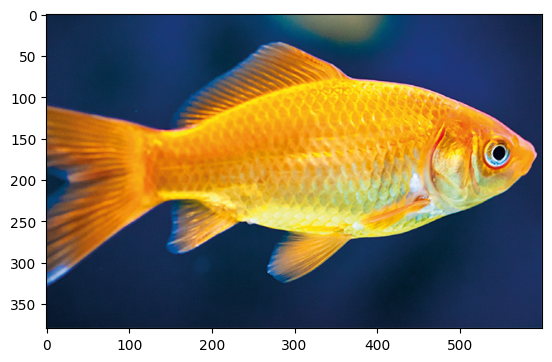

Predicted label: goldfish


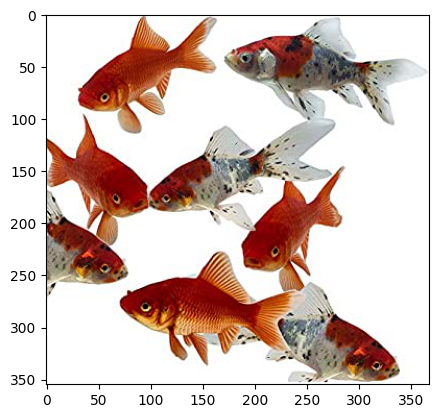

Predicted label: goldfish


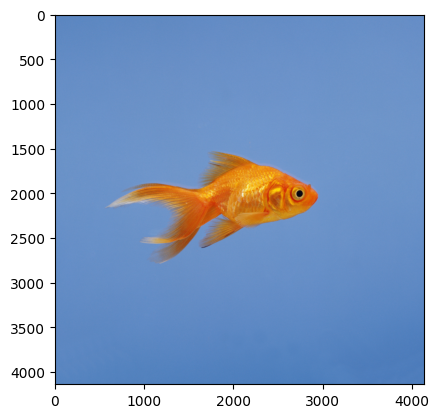

Predicted label: goldfish


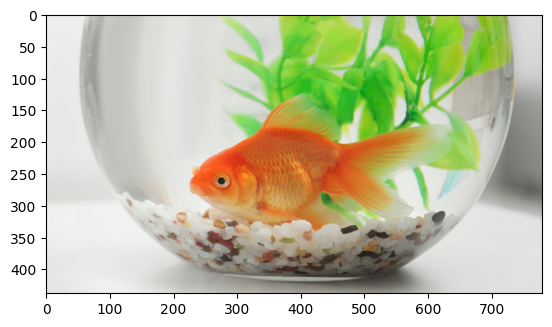

Predicted label: goldfish


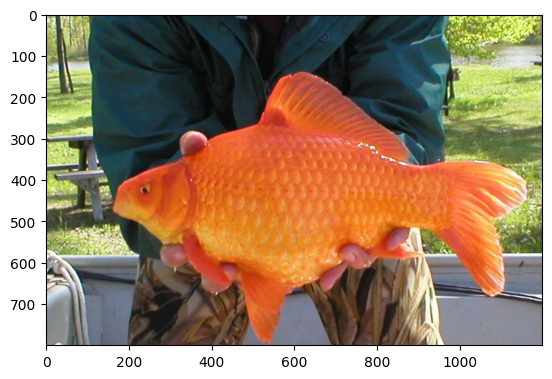

Predicted label: goldfish


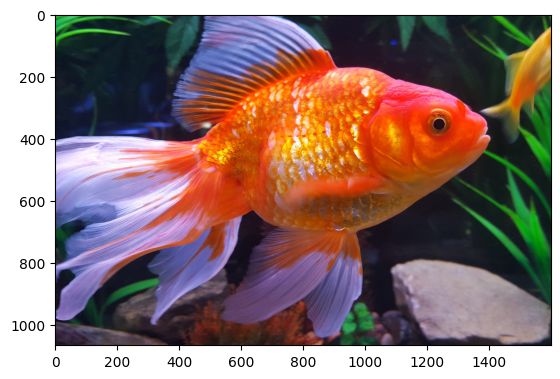

Predicted label: goldfish


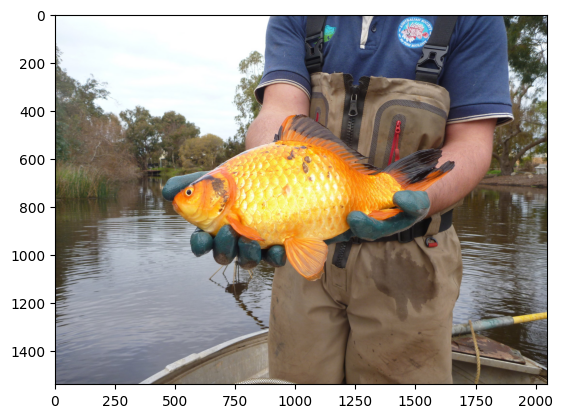

Predicted label: goldfish


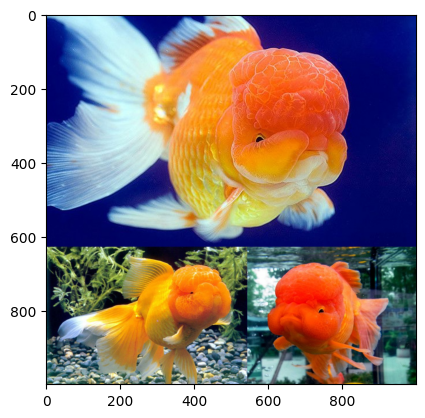

Predicted label: goldfish


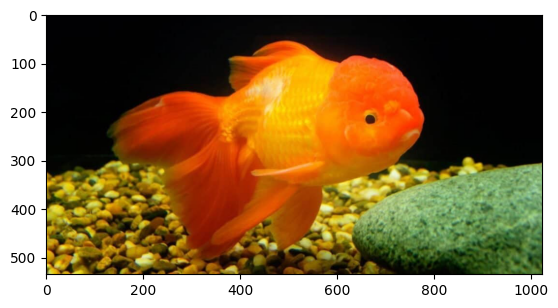

Predicted label: goldfish


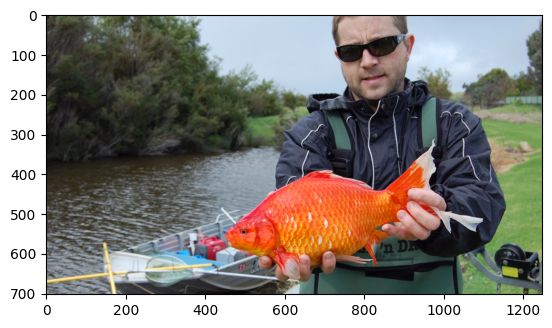

Predicted label: goldfish


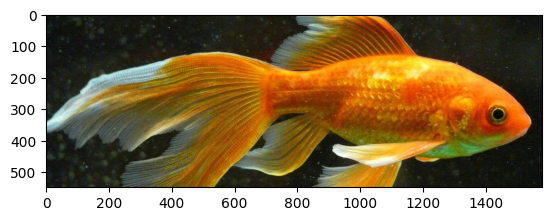

Predicted label: goldfish


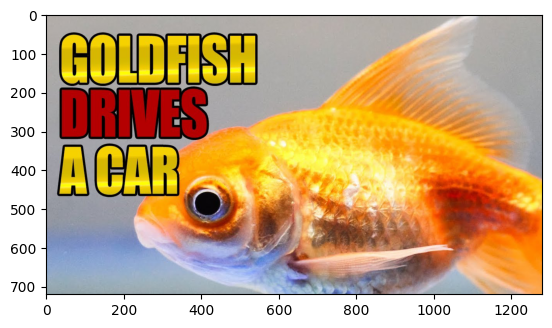

Predicted label: goldfish


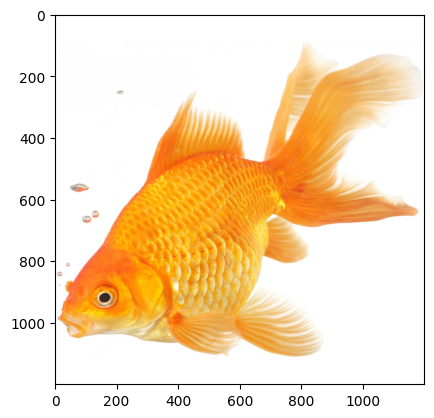

Predicted label: goldfish


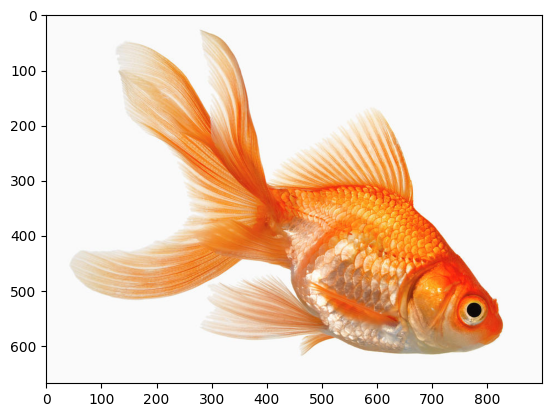

Predicted label: goldfish


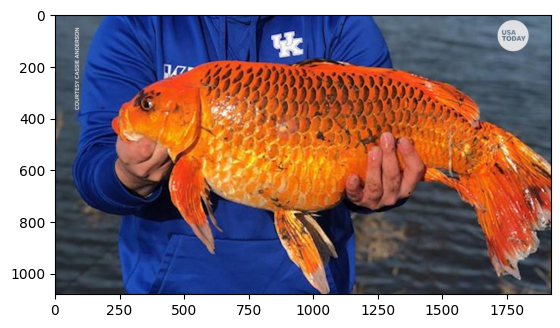

Predicted label: goldfish


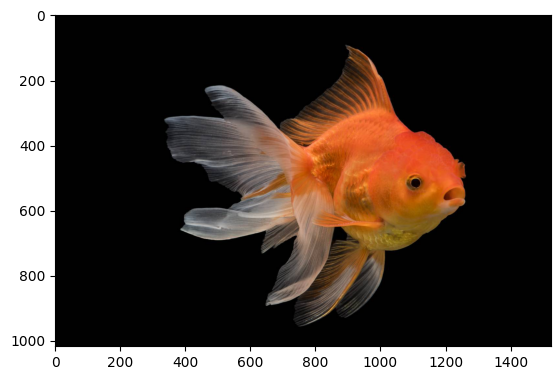

Predicted label: goldfish


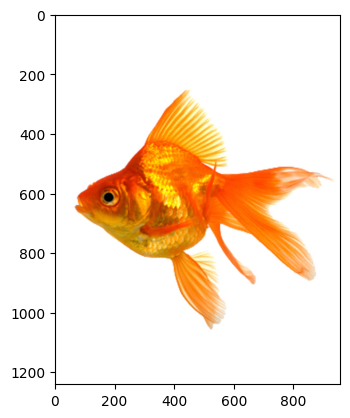

Predicted label: goldfish


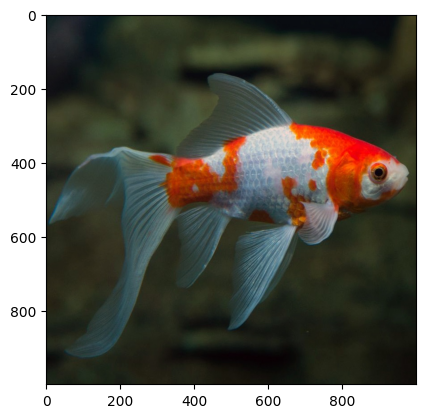

Predicted label: goldfish


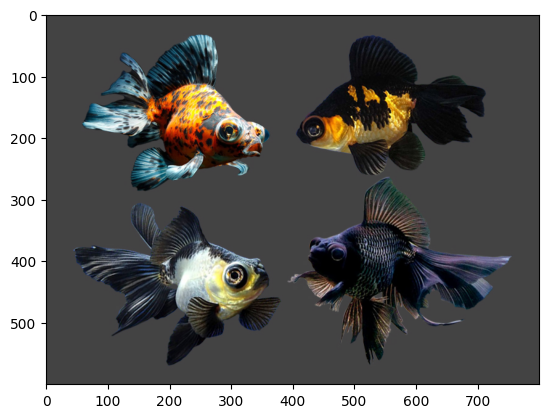

Predicted label: goldfish


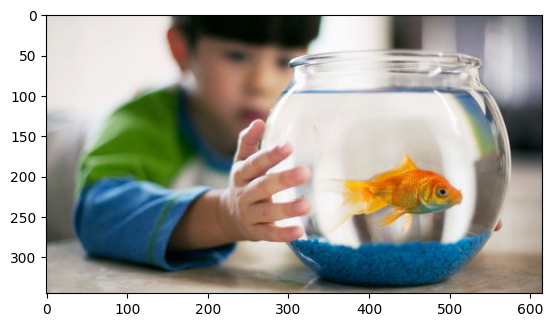

Predicted label: goldfish


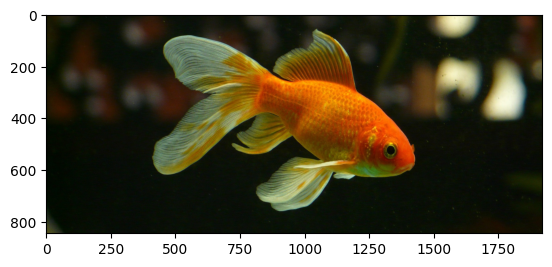

Predicted label: goldfish


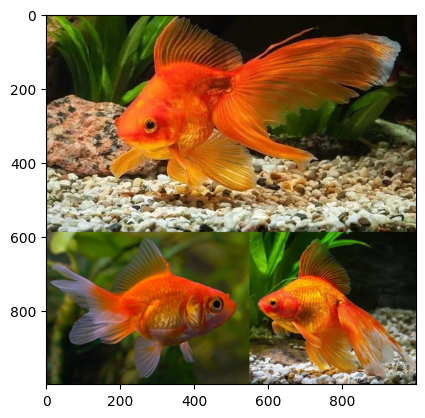

Predicted label: goldfish


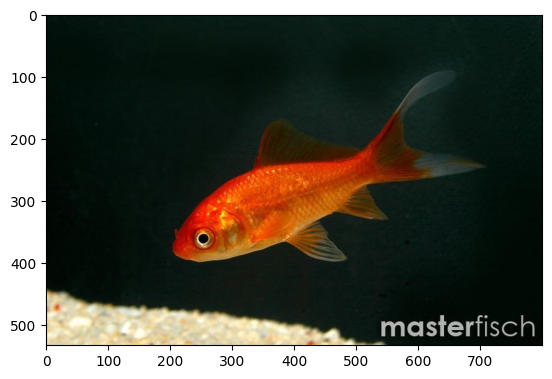

Predicted label: goldfish


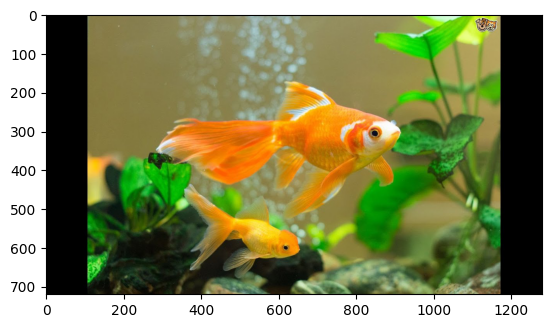

Predicted label: goldfish


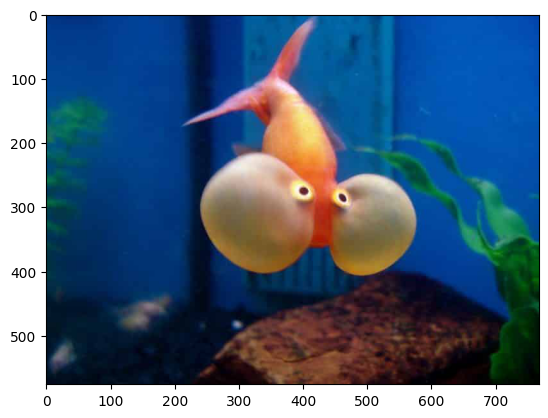

Predicted label: fish


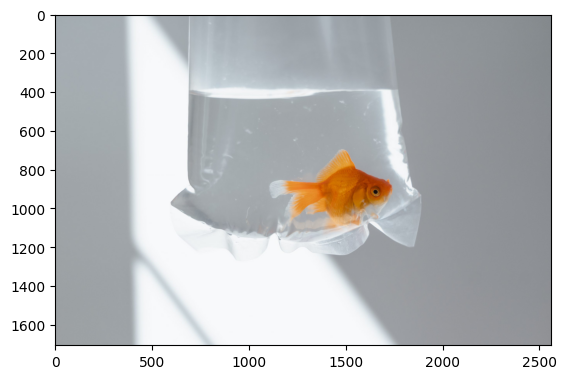

Predicted label: goldfish


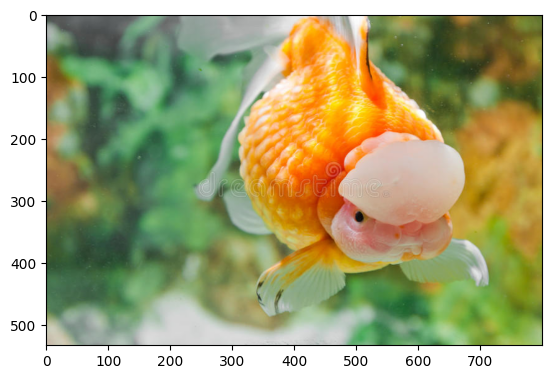

Predicted label: goldfish


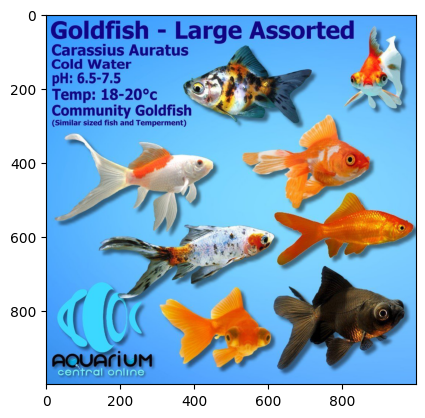

Predicted label: goldfish
error


In [55]:
# 動作確認

Idir = 'C:\\Users\\20044\\OneDrive\\ドキュメント\\kaggle\\detect_goldfish\\fish_images\\'
    
def detect(Idir):
    for top_dir in os.listdir(Idir):
        file_dir = os.path.join(Idir, top_dir)
        file_list = os.listdir(file_dir)
        for file_name in file_list:
            file_path = os.path.join(file_dir, file_name).replace('\\', '/')
        
            img = cv2.imread(file_path)
            img = Image.open(file_path)

            transform=ImageTransform(resize, mean, std)
            
            try:
                img_valid = transform(img, 'train')
            except RuntimeError:
                print("error")
                continue

            plt.imshow(img)
            plt.show()

            net.eval()
            img_valid = img_valid.unsqueeze(0).to(device)
            out = net(img_valid)
            # ラベルを求める
            _, preds = torch.max(out, 1)


            print('Predicted label:', myclasses[preds.item()])
        
#関数
detect(Idir)